# RA2CE feature: Multi_link_redundancy

This notebook contains an example of the **multi_link_redundancy analysis** of the RA2CE model. 

For this, you need a created network. Go back to the ra2ce_basics notebook if you do not have one yet.


First of all, we will import the packages we need to execute the notebook:

In [1]:
import ast
import random
import sys
import webbrowser
import geopandas as gpd
from IPython.display import display
import matplotlib.pyplot as plt
from matplotlib.pyplot import get_cmap
from matplotlib.colors import to_hex
from pathlib import Path
import rasterio

c:\Users\meije_le\Anaconda3\envs\ra2ce_env_tobreak2\lib\site-packages\geopandas\_compat.py:112: UserWarning: The Shapely GEOS version (3.11.0-CAPI-1.17.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


Import the RA2CE Handler

In [2]:
from ra2ce.ra2ce_handler import Ra2ceHandler #import the ra2cehandler to run ra2ce analyses

c:\Users\meije_le\Anaconda3\envs\ra2ce_env_tobreak2\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## What does the analysis do?

This analysis removes multiple disrupted links of the network. The disrupted links are indicated with an overlay of a hazard map and a threshold for disruption. For example, for flooding, the threshold could be a maximum of 0.5 m water on a road segment. For each disrupted link, a redundancy analysis is performed that identifies the best existing alternative route or, if there is no redundancy, the lack of alternative routes. The redundancy of each link is expressed in total distance or time for the alternative route, difference in distance/time between the alternative route and the original route (additional distance/time), and if there is an alternative route available, or not.

For example, in the network below we see that the links in red-purple have significant detour distance. The disruption of these roads because of flooding leads to detours with additional distances. Getting from point A to point B is not possible via the red road (second image). The alternative route in green is approximately 500 meters longer than the shortest path from A to B. The length of the alternative route is displayed as a property of the original link A-B. 

 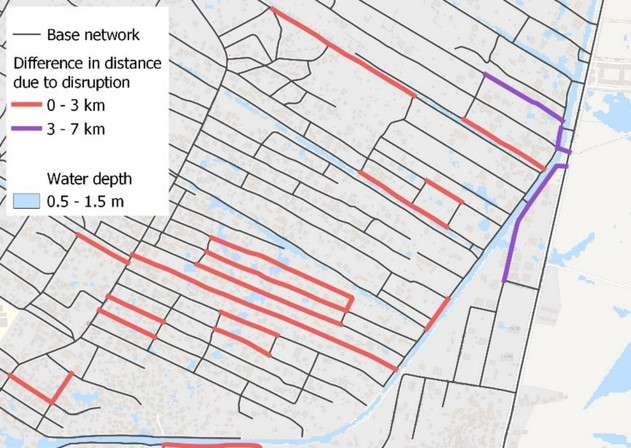 | 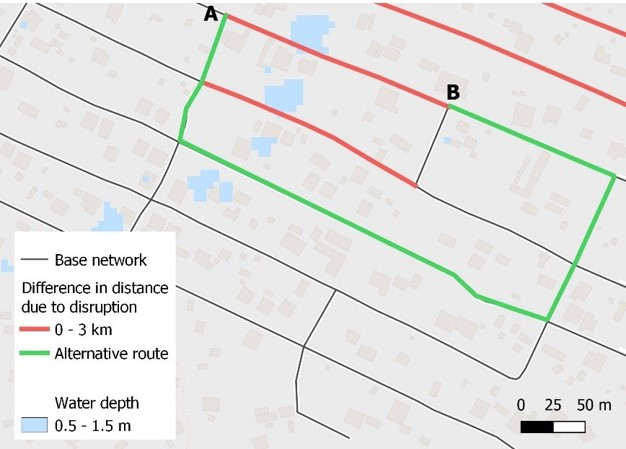 


## Hazard map
To perform this analysis we need a hazard map and a hazard overlay. If you have not done so, first familiarize yourself with the hazard overlay procedure as explained in the hazard_overlay notebook. Perform the hazard overlay, you need this output in this notebook

*Note: the hazard map needs to be in **.tif** format*

In [20]:
root_dir = Path(r'C:\python\beira\beira_05_m') # find the right folder
hazard_folder = root_dir / "static" / "hazard" # find the hazard folder where you locate your hazard map
hazard_map = hazard_folder / "max_flood_depth.tif" # set the location and name of the hazard map

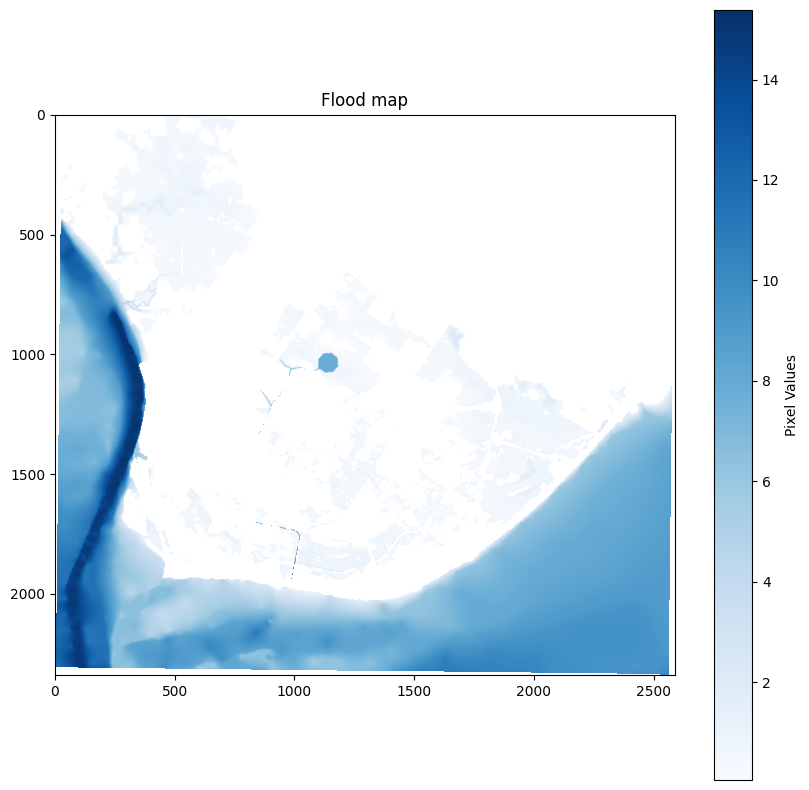

In [21]:
# Open the TIF file using rasterio
with rasterio.open(hazard_map) as src:
    # Read the TIF file as a numpy array
    tif_array = src.read(1)  # Change the band index (1) if necessary

plt.figure(figsize=(10, 10))
plt.imshow(tif_array, cmap='Blues')  # Change the colormap if desired
plt.colorbar(label='Pixel Values')
plt.title('Flood map')
plt.show()


We now need to update our analysis initialisation files using the preferred multi_link_redundancy analysis. This analysis gives insight into network criticality under a hazard situation.

Navigate to the folder on your local machine with which you want to perform the analysis, and change the analysis.ini accordingly.

With the **aggregate_wl** parameter, the user can choose which type of aggregation of the water level on the road segment (max, mean, min) the analysis should consider. The **threshold** is the hazard intensity which determines road disruption, in this case it is set to 0.5, which relates to 0.5 m of water depth on the road segment. But if you have binary hazard map for example, you can set the threshold to 1.

The analysis considers **distance** as measure for finding the optimal routes. With the parameter **calculate_route_without_disruption** set to True, RA2CE will calculate the routes with hazard disruption *and without*. Finally, with the parameters **save_shp** and **save_csv** the user can choose to save or not save resulting output shapefiles/gpkg (we are in a transition from shp to gpkg)/csvs.

**Analyses.ini content**
<br>
<br>
> [project] <br>
name = your_project_name <br>
<br>
[analysis1]<br>
name = multi-link origin closest destination<br>
analysis = multi_link_origin_closest_destination<br>
aggregate_wl = max<br>
threshold = 0.5<br>
weighing = distance<br>
calculate_route_without_disruption = True<br>
save_shp = True<br>
save_csv = True<br>
<br>

Set the paths to the initialization files and check if the files exist.

In [22]:
_network_ini_name = "network.ini" #set the name for the network.ini
_analyses_ini_name = "analyses.ini" #set the name for the analysis.ini

network_ini = root_dir / _network_ini_name
assert network_ini.is_file()

analyses_ini = root_dir / _analyses_ini_name
assert analyses_ini.is_file()

Run RA2CE

In [ ]:
handler = Ra2ceHandler(network=network_ini, analysis=analyses_ini)
handler.configure()
handler.run_analysis()

## Inspecting results
Let's do some output exploration!

In [23]:
analysis_output_path = root_dir / "output" / "multi_link_redundancy"
gdf = gpd.read_file(analysis_output_path / 'multi_link_redundancy_test.gpkg')
gdf.head() #show the file

,osmid,name,highway,maxspeed,oneway,length,rfid_c,rfid,avgspeed,time,...,bridge,u,v,key,alt_dist,alt_nodes,connected,diff_dist,hazard,geometry
0,820923407,Ava Mártires da Revolução,tertiary,60,False,70.0,1984,1386,60.0,4.0,...,nan,567924681,1934771035,0,NaN,nan,nan,NaN,EV1_ma,"LINESTRING (34.87673 -19.85047, 34.87737 -19.8..."
1,44785078,nan,tertiary,nan,True,70.0,"[80, 1, 12372]",2,59.0,4.0,...,nan,567924681,4095037852,0,NaN,nan,nan,NaN,EV1_ma,"LINESTRING (34.87673 -19.85047, 34.87642 -19.8..."
2,44785077,nan,tertiary,nan,True,71.0,"[12373, 79, 47]",19,59.0,4.0,...,nan,567924681,567929920,0,NaN,nan,nan,NaN,EV1_ma,"LINESTRING (34.87606 -19.85055, 34.87628 -19.8..."
3,326208102,nan,residential,nan,False,132.0,"[4536, 4501, 4438]",2723,60.0,8.0,...,nan,567924698,3328284864,0,NaN,nan,nan,NaN,EV1_ma,"LINESTRING (34.89312 -19.79809, 34.89331 -19.7..."
4,"[839392844, 839392845]",Rua Carlos Pereira,secondary,60,False,754.0,"[12680, 12712, 6856, 12714, 4620, 21, 27]",7,60.0,45.0,...,nan,567924698,567924713,0,NaN,nan,nan,NaN,EV1_ma,"LINESTRING (34.89980 -19.80126, 34.89942 -19.8..."


In [24]:
print(gdf.columns)

Index(['osmid', 'name', 'highway', 'maxspeed', 'oneway', 'length', 'rfid_c',
       'rfid', 'avgspeed', 'time', 'EV1_ma', 'EV1_fr', 'junction', 'lanes',
       'ref', 'bridge', 'u', 'v', 'key', 'alt_dist', 'alt_nodes', 'connected',
       'diff_dist', 'hazard', 'geometry'],
      dtype='object')


Explore how the hazard has impacted your network by checking the hazard attribute column which holds the overlay data with the network and the hazard

In [33]:
hazard_overlay_map = gdf.explore(column='EV1_ma', tiles="CartoDB positron", cmap='RdPu')
display(hazard_overlay_map)

Let's inspect how this impacts the connectivity of the network

'0' means that the road is impacted by the hazard and no detour is possible <br>
'1' means that the road is impacted by the hazard, but a detour is possible <br>
'nan' means that the network is not impacted by the hazard, therefore a detour is not necessary <br>

In [31]:
connected_map = gdf.explore(column='connected', tiles="CartoDB positron", cmap=['red', 'green', 'orange'])
display(connected_map)

We can now check the lengths of the alternative distance for each link in the network that has a detour given the hazard. We can do this with the attribute *'alt_dist'*. The alternative distance refers to the length of the detour for when the link itself is not available.

It can be that due to your specific hazards, there are no detours possible for impacted roads. The alt_dist column will hold only '0' values. This tells you that under this specific hazard, there is no detour available for that link in your network. If your networks is not impacted by the hazard, the alt_dist column will hold only 'Nan' values

In [35]:
alt_dist_map = gdf.explore(column='alt_dist', tiles="CartoDB positron", cmap='winter_r')
display(alt_dist_map)

Finally, we will look at the difference in distance of the original length of the segments and the alternative route, for all of the links in our network. We do this by visualizing the attribute *'diff_dist'*.

In [36]:
diff_dist_map = gdf.explore(column='diff_dist', tiles="CartoDB positron", cmap='winter_r')
display(diff_dist_map)